# **Introduction**

Determining the size of the asteroid may lead us to some conclusion about the impact of the asteroid. Size of the asteroid is measured in terms of diameter and predicting the diameter of the asteroid may help us in our quest of approximating the dangers or benefits the asteroids presents to the planet   
The following kernel contains the steps enumerated below for assessing the Asteroid Diameter dataset:

1. [Import data and python packages](#t1.)
2. [Assess Data Quality & Missing Values](#t2.)
    * 2.1. [Dropping features](#t2.1.)
    * 2.2. [data_arc - Missing Values](#t2.2.)
    * 2.3. [H - Missing Values](#t2.3.)
    * 2.4. [albedo - Missing Values](#t2.4.)    
    * 2.5. [Final Adjustments to Data](#t2.5.)
    * 2.6. [Get dummies](#t2.6.)
               
3. [Exploratory Data Analysis](#t3.)
    * 3.1. [Exploration of Diameter](#t3.1.)
    * 3.2. [Explaoration through pairplot](#t3.2.)
    * 3.3. [Exploration of a](#t3.3.)
    * 3.4. [Exploration of e](#t3.4.)
    * 3.5. [Exploration of i](#t3.5.)
    * 3.6. [Exploration of om](#t3.6.)
    * 3.7. [Exploration of w](#t3.7.)
    * 3.8. [Exploration of q](#t3.8.)
    * 3.9. [Exploration of ad](#t3.9.)
    * 3.10. [Exploration of per_y](#t3.10.)
    * 3.11. [Exploration of data_arc](#t3.11.)
    * 3.12. [Exploration of condition_code](#t3.12.)
    * 3.13. [Exploration of obs_used](#t3.13.)
    * 3.14. [Exploration of H](#t3.14.)
    * 3.15. [Exploration of neo](#t3.15.)
    * 3.16. [Exploration of pha](#t3.16.)
    * 3.17. [Exploration of albedo](#t3.17.)
    * 3.18. [Exploration of moid](#t3.18.)
    * 3.19. [Heatmap](#t3.19.)
4. [Modelling](#t4.)
    * 4.1. [Linear Regression](#t4.1.)
    * 4.2. [Ridge Regression](#t4.2.)
        * 4.2.1. [Ridge Regression using Cross validation](#t4.2.1.)
    * 4.3. [Lasso Regression](#t4.3.)
        * 4.3.1. [Lasso Regression Using Corss Validation](#t4.3.1.)    
    * 4.4. [ElasticNet Regression](#t4.4.)
        * 4.4.1. [ElasticNet Regression Using Corss Validation](#t4.4.1.)
    * 4.5. [Support Vector Regressor RBF Kernel](#t4.5.)
    * 4.6. [Support Vector Regressor Linear Kernel](#t4.6.)
    * 4.7. [Decision Tree Regression](#t4.7.)
        * 4.7.1. [Decision Tree Regression Grid Search corss validation](#t4.7.1.)
    * 4.8. [Random Forest tree Regression](#t4.8.)
        * 4.8.1. [Random Forest tree Regression Grid Search corss validation](#t4.8.1.)
    * 4.9. [Bagging meta Estiamtor](#t4.9.)
    * 4.10. [Adaboost](#t4.10.)
    * 4.11. [Gradient Boosting](#t4.11.)
    * 4.12. [XGBoost](#t4.12.)

<a id="t1."></a>
# 1. Import Data & Python Packages

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
#Reading the csv file in a dataframe
df=pd.read_csv('Asteroid.csv')
df.head()

C:\Users\krina\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (11,14,15,22,23) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,full_name,a,e,G,i,om,w,q,ad,per_y,...,rot_per,GM,BV,UB,IR,spec_B,spec_T,neo,pha,moid
0,1 Ceres,2.769165,0.076009,0.12,10.594067,80.305532,73.597694,2.558684,2.979647,4.608202,...,9.074170,62.6284,0.713,0.426,NaN,C,G,N,N,1.59478
1,2 Pallas,2.772466,0.230337,0.11,34.836234,173.080063,310.048857,2.133865,3.411067,4.616444,...,7.813200,14.3000,0.635,0.284,NaN,B,B,N,N,1.23324
2,3 Juno,2.669150,0.256942,0.32,12.988919,169.852760,248.138626,1.983332,3.354967,4.360814,...,7.210000,NaN,0.824,0.433,NaN,Sk,S,N,N,1.03454
3,4 Vesta,2.361418,0.088721,0.32,7.141771,103.810804,150.728541,2.151909,2.570926,3.628837,...,5.342128,17.8000,0.782,0.492,NaN,V,V,N,N,1.13948
4,5 Astraea,2.574249,0.191095,NaN,5.366988,141.576604,358.687608,2.082324,3.066174,4.130323,...,16.806000,NaN,0.826,0.411,NaN,S,S,N,N,1.09589


In [3]:
# to check the number of rows and columns in the dataset
df.shape

(839736, 27)

In [4]:
# to check out the  information about a DataFrame including the index dtype and column dtypes, non-null values and memory usage.
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 839736 entries, 0 to 839735
Data columns (total 27 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   full_name       839736 non-null  object 
 1   a               839734 non-null  float64
 2   e               839736 non-null  float64
 3   G               119 non-null     float64
 4   i               839736 non-null  float64
 5   om              839736 non-null  float64
 6   w               839736 non-null  float64
 7   q               839736 non-null  float64
 8   ad              839730 non-null  float64
 9   per_y           839735 non-null  float64
 10  data_arc        823947 non-null  float64
 11  condition_code  838743 non-null  object 
 12  n_obs_used      839736 non-null  int64  
 13  H               837042 non-null  float64
 14  diameter        137681 non-null  object 
 15  extent          18 non-null      object 
 16  albedo          136452 non-null  float64
 17  rot_per   

<a id="t2."></a>
# 2. Data Quality & Missing Value Assessment

In [5]:
# Checking the missing values in the dataset
df.isnull().sum()

full_name              0
a                      2
e                      0
G                 839617
i                      0
om                     0
w                      0
q                      0
ad                     6
per_y                  1
data_arc           15789
condition_code       993
n_obs_used             0
H                   2694
diameter          702055
extent            839718
albedo            703284
rot_per           820940
GM                839722
BV                838715
UB                838757
IR                839735
spec_B            838070
spec_T            838756
neo                    6
pha                16922
moid               16922
dtype: int64

In [6]:
#transforming to numeric, setting errors to NaN
df['diameter']= pd.to_numeric(df['diameter'],errors='coerce') 

In [7]:
#rows with nan diameters to drop
dropindexes = df['diameter'][df['diameter'].isnull()].index 
df = df.drop(dropindexes, axis=0) 

In [8]:
df.shape

(137680, 27)

In [9]:
df.isnull().sum()

full_name              0
a                      0
e                      0
G                 137562
i                      0
om                     0
w                      0
q                      0
ad                     0
per_y                  0
data_arc             140
condition_code         0
n_obs_used             0
H                    751
diameter               0
extent            137665
albedo              1232
rot_per           126493
GM                137667
BV                136676
UB                136716
IR                137679
spec_B            136311
spec_T            136716
neo                    0
pha                    0
moid                   0
dtype: int64

<a id="t2.1."></a>
## 2.1. Dropping Features

In [10]:
#Dropping the features with high ratio of missing values and full_name(as it is not relevant)
df=df.drop(['full_name','G','extent','rot_per','GM','BV','UB','IR','spec_B','spec_T'],axis=1)
df.head()

,a,e,i,om,w,q,ad,per_y,data_arc,condition_code,n_obs_used,H,diameter,albedo,neo,pha,moid
0,2.769165,0.076009,10.594067,80.305532,73.597694,2.558684,2.979647,4.608202,8822.0,0,1002,3.34,939.400,0.0900,N,N,1.59478
1,2.772466,0.230337,34.836234,173.080063,310.048857,2.133865,3.411067,4.616444,72318.0,0,8490,4.13,545.000,0.1010,N,N,1.23324
2,2.669150,0.256942,12.988919,169.852760,248.138626,1.983332,3.354967,4.360814,72684.0,0,7104,5.33,246.596,0.2140,N,N,1.03454
3,2.361418,0.088721,7.141771,103.810804,150.728541,2.151909,2.570926,3.628837,24288.0,0,9325,3.20,525.400,0.4228,N,N,1.13948
4,2.574249,0.191095,5.366988,141.576604,358.687608,2.082324,3.066174,4.130323,63431.0,0,2861,6.85,106.699,0.2740,N,N,1.09589


In [11]:
df.isnull().sum()

a                    0
e                    0
i                    0
om                   0
w                    0
q                    0
ad                   0
per_y                0
data_arc           140
condition_code       0
n_obs_used           0
H                  751
diameter             0
albedo            1232
neo                  0
pha                  0
moid                 0
dtype: int64

<a id="t2.2."></a>
## 2.2. data_arc - Missing Values

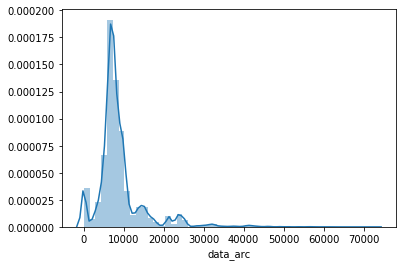

In [12]:
sns.distplot(df.data_arc.dropna())

In [13]:
#descrption about data_arc feature
print(df['data_arc'].describe())
print('\nThe maximum repeated value is : ',df['data_arc'].value_counts().index[0])

count    137540.000000
mean       8908.697681
std        6150.505469
min           1.000000
25%        6265.000000
50%        7492.000000
75%        9655.000000
max       72684.000000
Name: data_arc, dtype: float64

The maximum repeated value is :  1.0


In [14]:
#Since median is greater than mean, it is positively skewed. Hence, imputing with median.
df['data_arc'].fillna(df['data_arc'].median() , inplace = True) # mean is the best option here 

<a id="t2.3."></a>
## 2.3. H - Missing Values

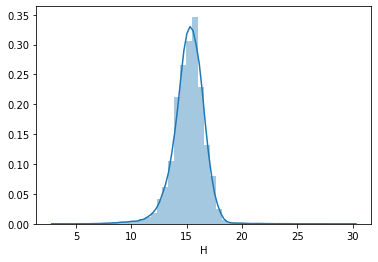

In [15]:
sns.distplot(df.H.dropna())

In [16]:
print(df['H'].describe())
print('\nThe maximum repeated value is : ',df['H'].value_counts().index[0])

count    136929.00000
mean         15.17739
std           1.40739
min           3.20000
25%          14.40000
50%          15.30000
75%          16.10000
max          29.90000
Name: H, dtype: float64

The maximum repeated value is :  15.2


In [17]:
# Since mean and median are close, imputing the missing values with mean.
df['H'].fillna(df['H'].mean() , inplace = True)

<a id="t2.4."></a>
## 2.4. Albedo - Missing Values

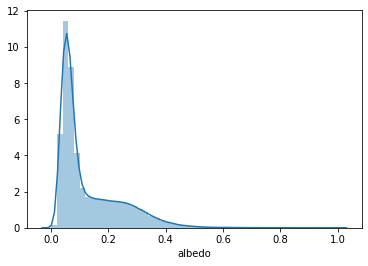

In [18]:
sns.distplot(df.albedo.dropna())

In [19]:
print(df['albedo'].describe())
print('\nThe maximum repeated value is : ',df['albedo'].value_counts().index[0])

count    136448.000000
mean          0.130050
std           0.109984
min           0.001000
25%           0.053000
50%           0.078000
75%           0.188000
max           1.000000
Name: albedo, dtype: float64

The maximum repeated value is :  0.057


In [20]:
#Since median is greater than mean, it is positively skewed. Hence, imputing with median.
df['albedo'].fillna(df['albedo'].median() , inplace = True)

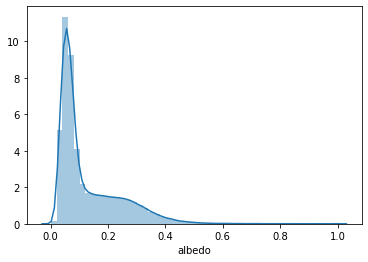

In [21]:
sns.distplot(df.albedo)

In [22]:
df.isnull().sum()

a                 0
e                 0
i                 0
om                0
w                 0
q                 0
ad                0
per_y             0
data_arc          0
condition_code    0
n_obs_used        0
H                 0
diameter          0
albedo            0
neo               0
pha               0
moid              0
dtype: int64

<a id="t2.5."></a>
## 2.5. Final Adjustment to the data

In [23]:
# To know the categries present in the categorical features.
list_of_cols = df.select_dtypes(['object'])
for col in list_of_cols:
    print(str(col) + ": "+ str(df[col].unique()))

condition_code: [0 1 3 2 '0' '1' '2' '3' '4' '5' '9' '7' 5.0 6.0 4.0 7.0 9.0 8.0 '8' '6']
neo: ['N' 'Y']
pha: ['N' 'Y']


#### Condition code is the orbit condition code which has the value between 0 and 9. As we can see from above, the values are in different formats.

In [24]:
for val in df.condition_code.unique():
    if type(val) == int or type(val) == float:
        df.loc[df.condition_code == val, 'condition_code'] = str(int(val))
df.condition_code = df.condition_code.astype('object')
df.condition_code.value_counts()

0    128209
9      6551
1      1372
2       397
5       334
7       207
6       188
4       177
3       168
8        77
Name: condition_code, dtype: int64

In [25]:
df.to_csv('asteroid_cleaned.csv') 

In [26]:
df=pd.read_csv('asteroid_cleaned.csv')
df.drop(['Unnamed: 0'], axis=1,inplace=True)
df.head()

,a,e,i,om,w,q,ad,per_y,data_arc,condition_code,n_obs_used,H,diameter,albedo,neo,pha,moid
0,2.769165,0.076009,10.594067,80.305532,73.597694,2.558684,2.979647,4.608202,8822.0,0,1002,3.34,939.400,0.0900,N,N,1.59478
1,2.772466,0.230337,34.836234,173.080063,310.048857,2.133865,3.411067,4.616444,72318.0,0,8490,4.13,545.000,0.1010,N,N,1.23324
2,2.669150,0.256942,12.988919,169.852760,248.138626,1.983332,3.354967,4.360814,72684.0,0,7104,5.33,246.596,0.2140,N,N,1.03454
3,2.361418,0.088721,7.141771,103.810804,150.728541,2.151909,2.570926,3.628837,24288.0,0,9325,3.20,525.400,0.4228,N,N,1.13948
4,2.574249,0.191095,5.366988,141.576604,358.687608,2.082324,3.066174,4.130323,63431.0,0,2861,6.85,106.699,0.2740,N,N,1.09589


In [27]:
df.shape

(137680, 17)

<a id="t3."></a>
# 3. Exploratory Data Analysis

<a id="t3.1."></a>
## 3.1. Exploration of Diameter

count    137680.000000
mean          5.480873
std           9.365499
min           0.002500
25%           2.770000
50%           3.956000
75%           5.741000
max         939.400000
Name: diameter, dtype: float64


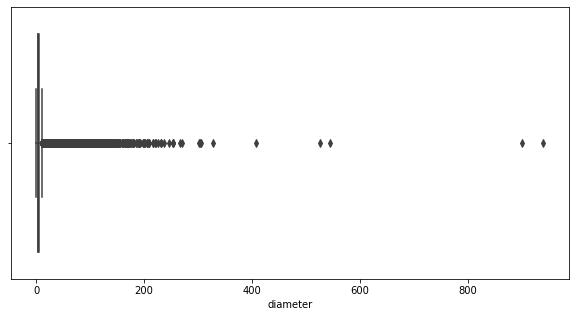

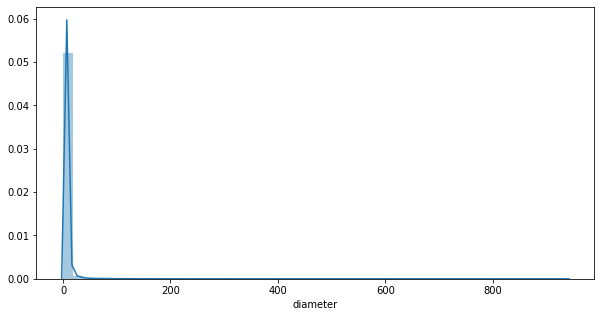

In [28]:
print(df['diameter'].describe())

import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['diameter'])
plt.show()

# Distribution on rent 
plt.figure(figsize=(10,5))
sns.distplot(df['diameter']);
plt.show()

In [29]:
#skewness and kurtosis
print('Skewness : %f'%df['diameter'].skew())
print('Kurtosis : %f'%df['diameter'].kurt())

Skewness : 26.043024
Kurtosis : 1658.867197


#### As we can see that the data is highly skewed and the kurtosis is also very high. The difference between the 75th percentile and the maximum value is very large. However the outliers in this case are asteroids with high diameters, that is there is no error in this case. This information is relevant for the data.

In [30]:
def iqr(x):
    return x.quantile(q=0.75)-x.quantile(q=0.25)

def outlier_count(x):
    upper_out=x.quantile(q=0.75)+1.5*iqr(x)
    lower_out=x.quantile(q=0.25)-1.5*iqr(x)
    
    return len(x[x>upper_out])+len(x[x<lower_out])

In [31]:
def num_count_summary(df,id_cols):
    df_num=df.drop(columns=id_cols)._get_numeric_data()
    data_info_num=pd.DataFrame()
    try:
        i=0
        for c in df_num.columns:
            data_info_num.loc[c,'Negative value count'] = df_num[df_num[c]<0].shape[0]
            data_info_num.loc[c,'Positive value count'] = df_num[df_num[c]>0].shape[0]
            data_info_num.loc[c,'Zeroes count'] = df_num[df_num[c]==0].shape[0]
            data_info_num.loc[c,'Unique count'] = len(df_num[c].unique())
            data_info_num.loc[c,'Negative infinity count'] = df_num[df_num[c]== -np.inf].shape[0]
            data_info_num.loc[c,'Positive infinity count'] = df_num[df_num[c]== np.inf].shape[0]
            data_info_num.loc[c,'Count of outliers'] = outlier_count(df_num[c])
            i=i+1
    except:
        pass
    return data_info_num

In [32]:
num_count_summary(df,['diameter'])

,Negative value count,Positive value count,Zeroes count,Unique count,Negative infinity count,Positive infinity count,Count of outliers
a,0.0,137680.0,0.0,137680.0,0.0,0.0,3385.0
e,0.0,137680.0,0.0,137680.0,0.0,0.0,1496.0
i,0.0,137680.0,0.0,137680.0,0.0,0.0,4220.0
om,0.0,137680.0,0.0,137680.0,0.0,0.0,0.0
w,0.0,137680.0,0.0,137680.0,0.0,0.0,0.0
q,0.0,137680.0,0.0,137680.0,0.0,0.0,2703.0
ad,0.0,137680.0,0.0,137680.0,0.0,0.0,3543.0
per_y,0.0,137680.0,0.0,137680.0,0.0,0.0,3372.0
data_arc,0.0,137680.0,0.0,19608.0,0.0,0.0,22260.0
condition_code,0.0,9471.0,128209.0,10.0,0.0,0.0,9471.0


In [33]:
def stats_summary(df,id_cols):
    df_num=df.drop(columns=id_cols)._get_numeric_data()
    data_stats_num=pd.DataFrame()
    
    try:
        data_stats_num = pd.concat([df_num.describe().transpose(),
                                    pd.DataFrame(df_num.quantile(q=0.1)),
                                    pd.DataFrame(df_num.quantile(q=0.9)),
                                    pd.DataFrame(df_num.quantile(q=0.95))],axis=1)
        data_stats_num.columns = ['count','mean','std','min','25%','50%','75%','max','10%','90%','95%']
    except:
        pass
    return data_stats_num

In [34]:
stats_summary(df,['diameter'])

,count,mean,std,min,25%,50%,75%,max,10%,90%,95%
a,137680.0,2.814523,1.522517,0.626226,2.536646,2.750781,3.092506,389.145964,2.309871,3.177899,3.217470
e,137680.0,0.145478,0.077572,0.000489,0.089611,0.138538,0.191134,0.984348,0.054519,0.239737,0.272365
i,137680.0,10.350903,6.835956,0.021855,5.121644,9.392078,13.742370,170.323647,2.845174,19.469849,24.773588
om,137680.0,169.829097,102.713694,0.000735,82.329126,160.438710,256.280735,359.990858,35.245572,321.204695,341.182979
w,137680.0,181.899414,103.557891,0.004466,91.935841,183.661868,271.762261,359.995174,37.619151,323.758026,341.839256
q,137680.0,2.402551,0.516138,0.081882,2.068878,2.363854,2.685778,40.465671,1.892254,2.883929,2.995295
ad,137680.0,3.226496,2.895929,0.999956,2.864377,3.167355,3.468519,772.201080,2.635935,3.733402,3.907314
per_y,137680.0,4.883984,25.528493,0.495569,4.040154,4.562388,5.438437,7676.742943,3.510669,5.665241,5.771383
data_arc,137680.0,8907.257111,6147.543402,1.000000,6266.000000,7492.000000,9652.000000,72684.000000,4486.000000,15149.000000,22421.000000
condition_code,137680.0,0.488088,1.971854,0.000000,0.000000,0.000000,0.000000,9.000000,0.000000,0.000000,6.000000


<a id="t3.2."></a>
## 3.2. Exploration through pairplot

In [35]:
sns.pairplot(df, height=10)
plt.show()

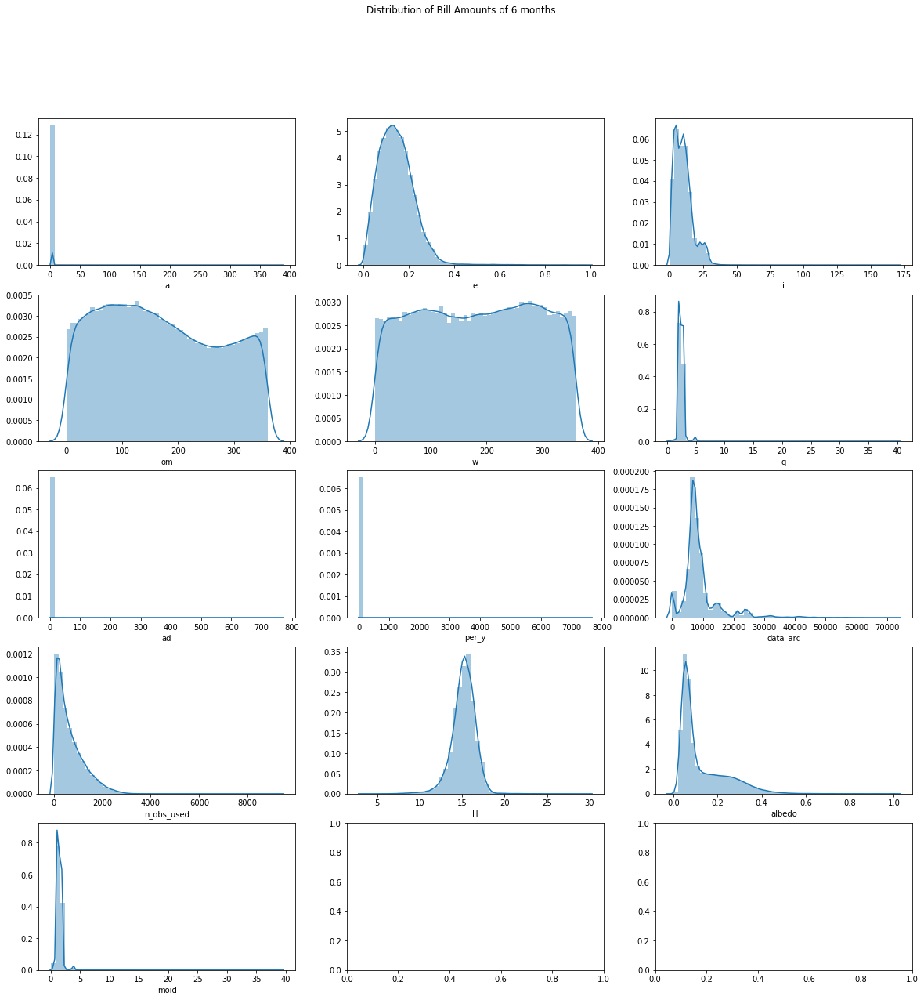

In [36]:
f, axes = plt.subplots(5, 3, figsize=(20, 20), facecolor='white')
f.suptitle('Distribution of Bill Amounts of 6 months')
ax1 = sns.distplot(df["a"], ax=axes[0,0])
ax2 = sns.distplot(df["e"], ax=axes[0,1])
ax3 = sns.distplot(df["i"], ax=axes[0,2])
ax4 = sns.distplot(df["om"], ax=axes[1,0])
ax5 = sns.distplot(df["w"], ax=axes[1,1])
ax6 = sns.distplot(df["q"], ax=axes[1,2])
ax7 = sns.distplot(df["ad"], ax=axes[2,0])
ax8 = sns.distplot(df["per_y"], ax=axes[2,1])
ax9 = sns.distplot(df["data_arc"], ax=axes[2,2])
ax10 = sns.distplot(df["n_obs_used"], ax=axes[3,0])
ax11 = sns.distplot(df["H"], ax=axes[3,1])
ax12 = sns.distplot(df["albedo"], ax=axes[3,2]);
ax13 = sns.distplot(df["moid"], ax=axes[4,0]);

In [37]:
columns=['diameter','a','e','i','om','w','q','ad','per_y','data_arc','n_obs_used','H','albedo','moid']
for col in columns:
    print('Skewness of %s: %f'%(col,df[col].skew()))

Skewness of diameter: 26.043024
Skewness of a: 179.547107
Skewness of e: 1.395735
Skewness of i: 1.635546
Skewness of om: 0.183755
Skewness of w: -0.028100
Skewness of q: 7.311342
Skewness of ad: 203.525845
Skewness of per_y: 254.302884
Skewness of data_arc: 2.697089
Skewness of n_obs_used: 1.372473
Skewness of H: -0.669907
Skewness of albedo: 1.709701
Skewness of moid: 7.597408


In [38]:
df.loc[:,['diameter','a','e','i','q','ad','per_y','data_arc','n_obs_used','albedo','moid']] = np.log(df[['diameter','a','e','i','q','ad','per_y','data_arc','n_obs_used','albedo','moid']])

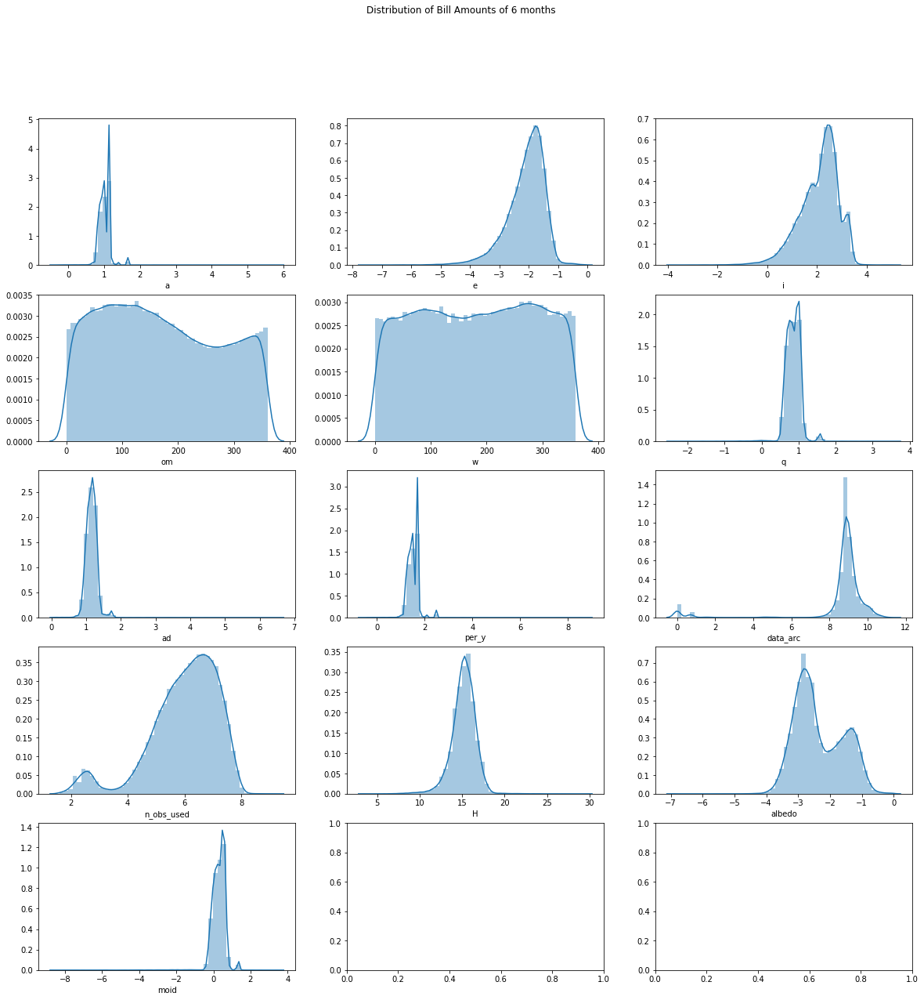

In [39]:
f, axes = plt.subplots(5, 3, figsize=(20, 20), facecolor='white')
f.suptitle('Distribution of Bill Amounts of 6 months')
ax1 = sns.distplot(df["a"], ax=axes[0,0])
ax2 = sns.distplot(df["e"], ax=axes[0,1])
ax3 = sns.distplot(df["i"], ax=axes[0,2])
ax4 = sns.distplot(df["om"], ax=axes[1,0])
ax5 = sns.distplot(df["w"], ax=axes[1,1])
ax6 = sns.distplot(df["q"], ax=axes[1,2])
ax7 = sns.distplot(df["ad"], ax=axes[2,0])
ax8 = sns.distplot(df["per_y"], ax=axes[2,1])
ax9 = sns.distplot(df["data_arc"], ax=axes[2,2])
ax10 = sns.distplot(df["n_obs_used"], ax=axes[3,0])
ax11 = sns.distplot(df["H"], ax=axes[3,1])
ax12 = sns.distplot(df["albedo"], ax=axes[3,2]);
ax13 = sns.distplot(df["moid"], ax=axes[4,0]);

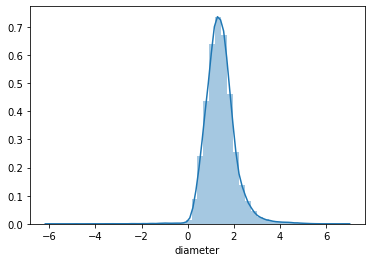

In [40]:
sns.distplot(df.diameter)

In [41]:
columns=['diameter','a','e','i','om','w','q','ad','per_y','data_arc','n_obs_used','H','albedo','moid']
for col in columns:
    print('Skewness of %s: %f'%(col,df[col].skew()))

Skewness of diameter: 0.734118
Skewness of a: 1.561167
Skewness of e: -1.196766
Skewness of i: -0.860987
Skewness of om: 0.183755
Skewness of w: -0.028100
Skewness of q: -0.820930
Skewness of ad: 2.149887
Skewness of per_y: 1.561167
Skewness of data_arc: -3.802503
Skewness of n_obs_used: -1.123838
Skewness of H: -0.669907
Skewness of albedo: 0.367260
Skewness of moid: -4.321123


In [42]:
#type(numeric_features)

<a id="t3.3."></a>
## 3.3. Exploration of a (A -> semi-major axis)

In [43]:
df['a'].describe()

count    137680.000000
mean          1.018989
std           0.158305
min          -0.468045
25%           0.930843
50%           1.011885
75%           1.128982
max           5.963955
Name: a, dtype: float64

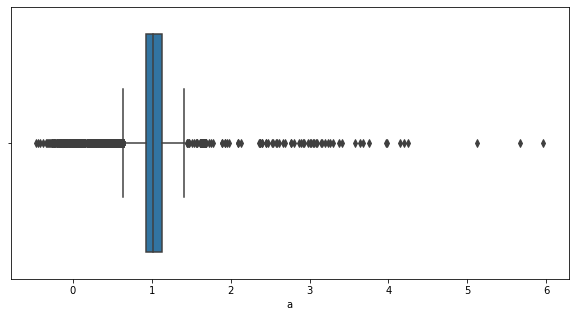

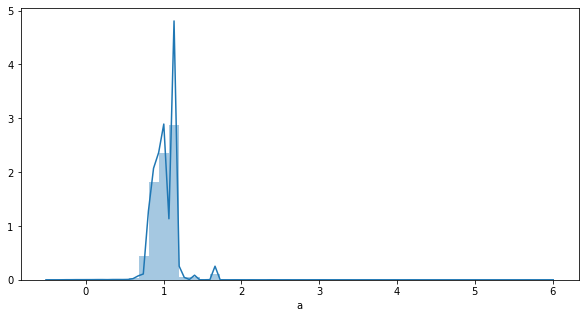

In [44]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['a'])
plt.show()


plt.figure(figsize=(10,5))
sns.distplot(df['a']);
plt.show()

<a id="t3.4."></a>
## 3.4. Exploration of e (E -> eccentricity)

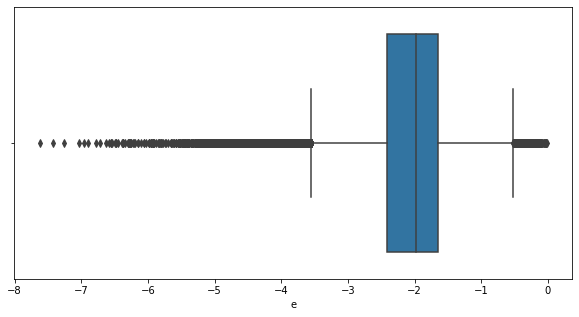

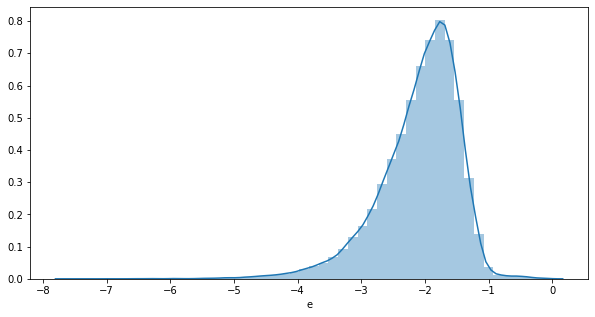

In [45]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['e'])
plt.show()


plt.figure(figsize=(10,5))
sns.distplot(df['e']);
plt.show()

<a id="t3.5."></a>
## 3.5. Exploration of i (I -> Inclination with respect to x-y ecliptic plane (degree))

In [46]:
df['i'].describe()

count    137680.000000
mean          2.091022
std           0.771755
min          -3.823330
25%           1.633476
50%           2.239867
75%           2.620484
max           5.137700
Name: i, dtype: float64

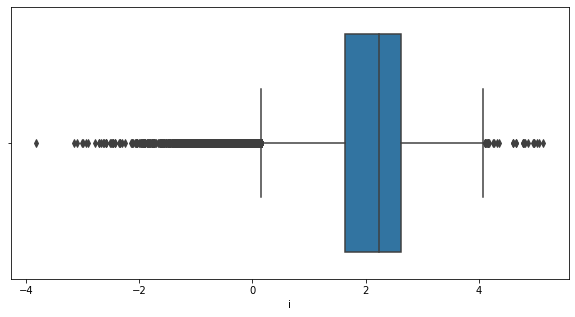

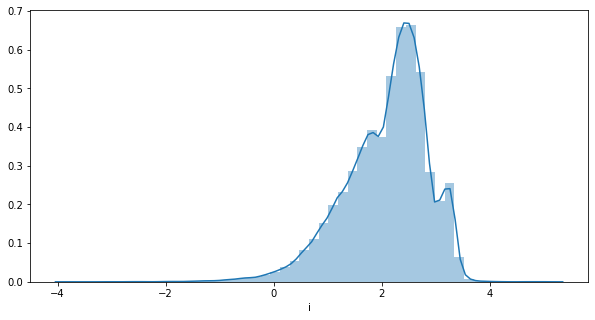

In [47]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['i'])
plt.show()

 
plt.figure(figsize=(10,5))
sns.distplot(df['i']);
plt.show()

<a id="t3.6."></a>
## 3.6. Exploration of om (Om -> Longitude of the ascending node)

In [48]:
df['om'].describe()

count    137680.000000
mean        169.829097
std         102.713694
min           0.000735
25%          82.329126
50%         160.438710
75%         256.280735
max         359.990858
Name: om, dtype: float64

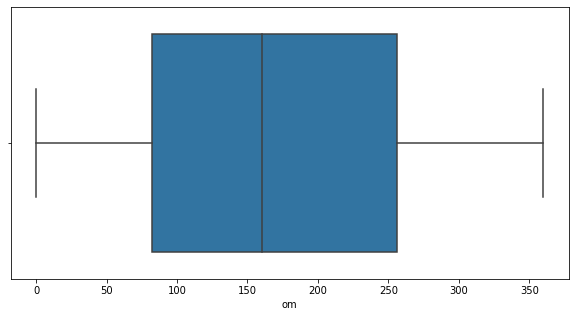

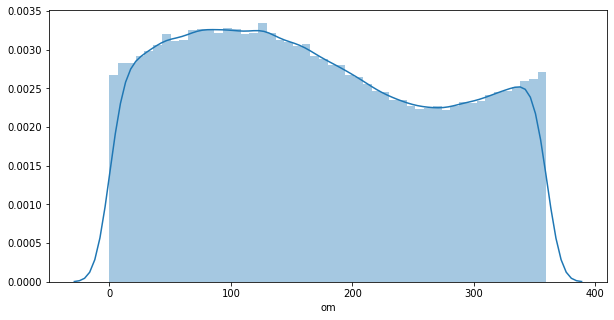

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['om'])
plt.show()

 
plt.figure(figsize=(10,5))
sns.distplot(df['om']);
plt.show()

<a id="t3.7."></a>
## 3.7. Exploration of w (W -> argument of perihelion )

In [50]:
df['w'].describe()

count    137680.000000
mean        181.899414
std         103.557891
min           0.004466
25%          91.935841
50%         183.661868
75%         271.762261
max         359.995174
Name: w, dtype: float64

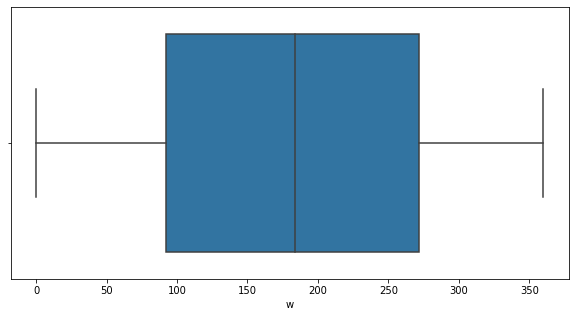

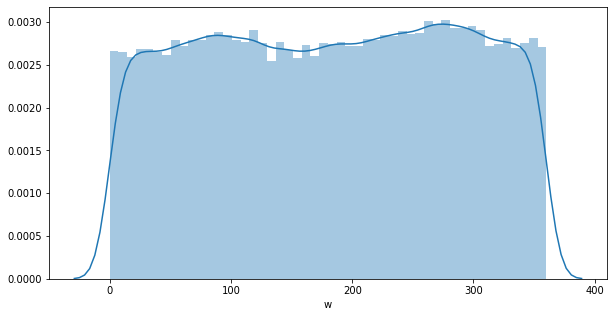

In [51]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['w'])
plt.show()


plt.figure(figsize=(10,5))
sns.distplot(df['w']);
plt.show()

<a id="t3.8."></a>
## 3.8. Exploration of q (Q -> perihelion distance)

In [52]:
df['q'].describe()

count    137680.000000
mean          0.856882
std           0.199647
min          -2.502474
25%           0.727006
50%           0.860293
75%           0.987970
max           3.700454
Name: q, dtype: float64

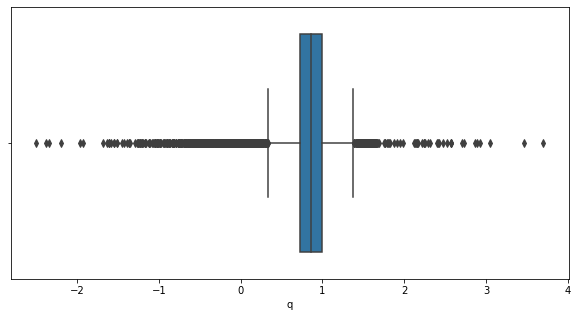

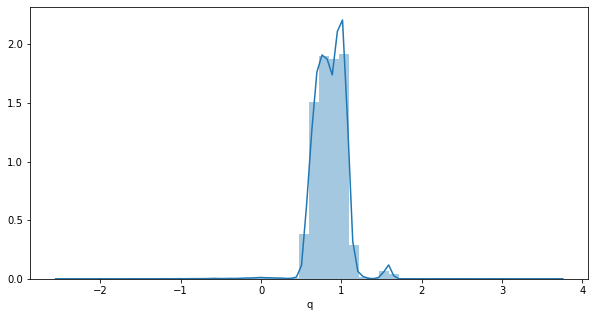

In [53]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['q'])
plt.show()

 
plt.figure(figsize=(10,5))
sns.distplot(df['q']);
plt.show()

<a id="t3.9."></a>
## 3.9. Exploration of ad (Ad -> aphelion distance )

In [54]:
df['ad'].describe()

count    137680.000000
mean          1.152623
std           0.161988
min          -0.000044
25%           1.052351
50%           1.152897
75%           1.243728
max           6.649245
Name: ad, dtype: float64

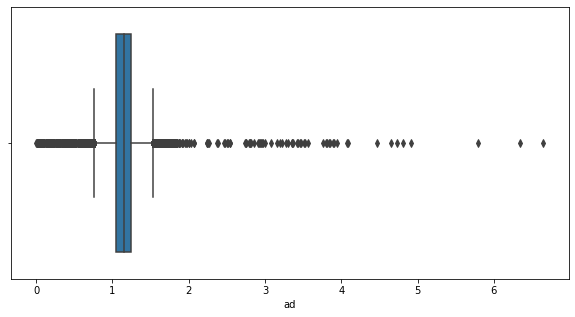

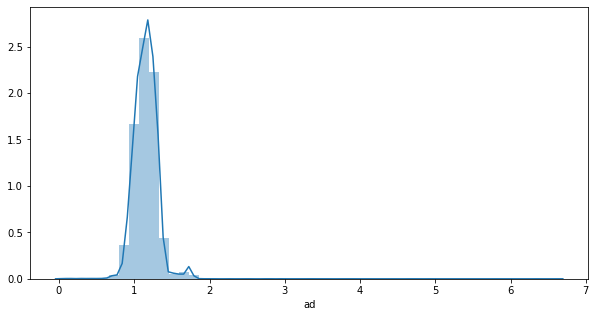

In [55]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['ad'])
plt.show()

 
plt.figure(figsize=(10,5))
sns.distplot(df['ad']);
plt.show()

<a id="t3.10."></a>
## 3.10. Exploration of per_y (Per_y -> Orbital period )

In [56]:
df['per_y'].describe()

count    137680.000000
mean          1.528503
std           0.237457
min          -0.702048
25%           1.396283
50%           1.517846
75%           1.693492
max           8.945951
Name: per_y, dtype: float64

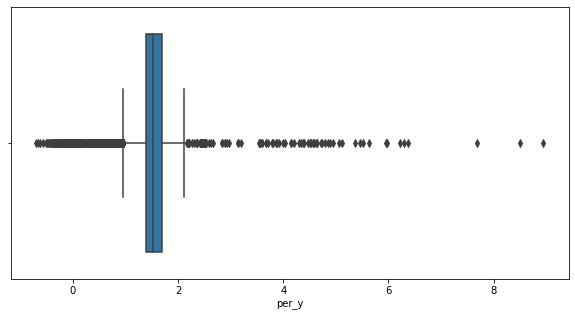

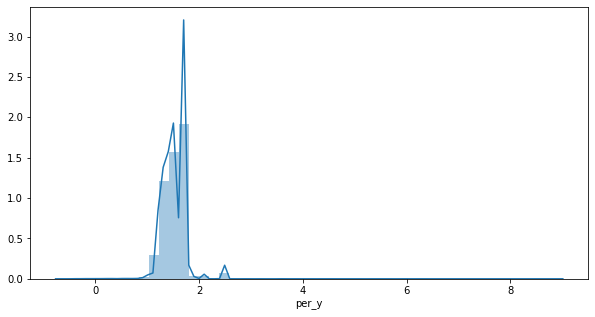

In [57]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['per_y'])
plt.show()


plt.figure(figsize=(10,5))
sns.distplot(df['per_y']);
plt.show()

<a id="t3.11."></a>
## 3.11. Exploration of data_arc

In [58]:
df['data_arc'].describe()

count    137680.000000
mean          8.593392
std           1.918123
min           0.000000
25%           8.742893
50%           8.921591
75%           9.174920
max          11.193877
Name: data_arc, dtype: float64

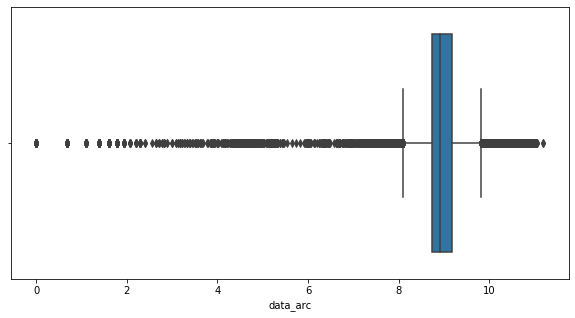

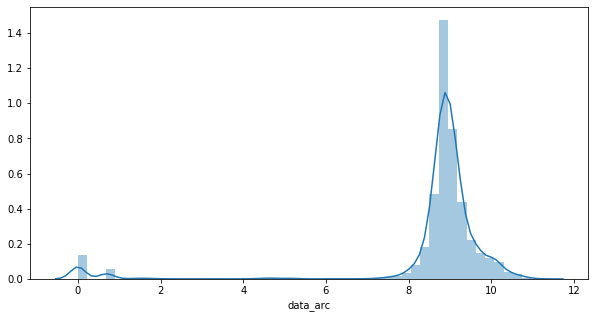

In [59]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['data_arc'])
plt.show()

 
plt.figure(figsize=(10,5))
sns.distplot(df['data_arc']);
plt.show()

<a id="t3.12."></a>
## 3.12. Exploration of condition code 

In [60]:
df['condition_code'].describe()

count    137680.000000
mean          0.488088
std           1.971854
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           9.000000
Name: condition_code, dtype: float64

In [61]:
df['condition_code'].value_counts()

0    128209
9      6551
1      1372
2       397
5       334
7       207
6       188
4       177
3       168
8        77
Name: condition_code, dtype: int64

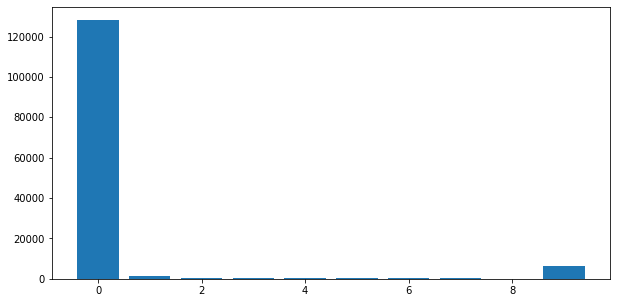

In [62]:
plt.figure(figsize=(10,5))
plt.bar(df['condition_code'].value_counts().index , df['condition_code'].value_counts().values);
plt.show()

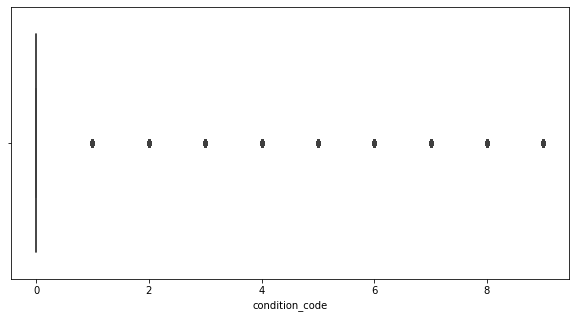

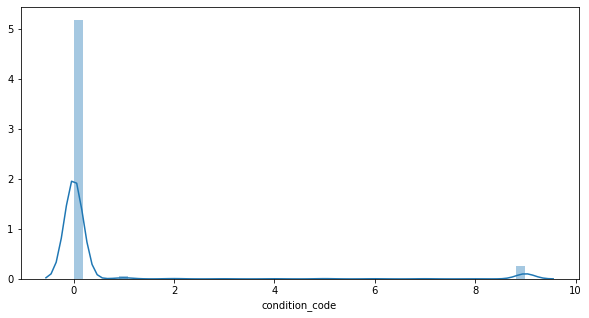

In [63]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['condition_code'])
plt.show()

# Distribution on rent 
plt.figure(figsize=(10,5))
sns.distplot(df['condition_code']);
plt.show()

<a id="t3.13."></a>
## 3.13. Exploration of Observation used

In [64]:
df['n_obs_used'].describe()

count    137680.000000
mean          5.979400
std           1.217875
min           1.609438
25%           5.365976
50%           6.180017
75%           6.864848
max           9.140454
Name: n_obs_used, dtype: float64

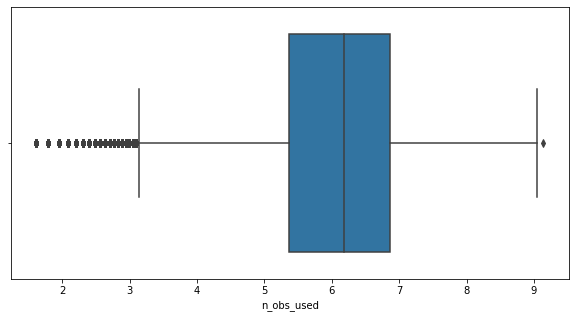

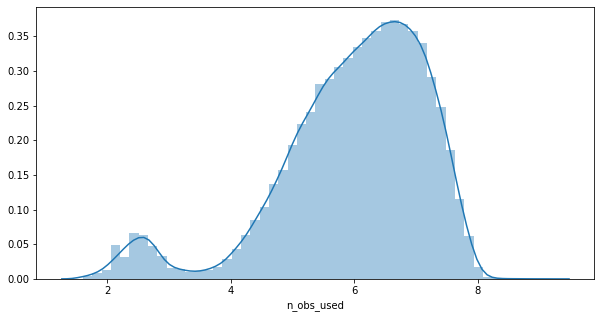

In [65]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['n_obs_used'])
plt.show()

# Distribution on rent 
plt.figure(figsize=(10,5))
sns.distplot(df['n_obs_used']);
plt.show()

<a id="t3.14."></a>
## 3.14. Exploration of H (H -> Absolute Magnitude parameter)

In [66]:
df['H'].describe()

count    137680.000000
mean         15.177390
std           1.403546
min           3.200000
25%          14.400000
50%          15.300000
75%          16.100000
max          29.900000
Name: H, dtype: float64

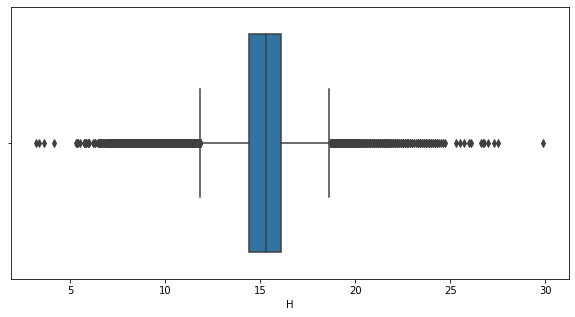

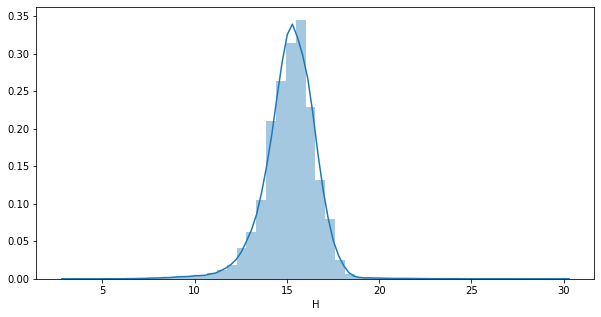

In [67]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['H'])
plt.show()

 
plt.figure(figsize=(10,5))
sns.distplot(df['H']);
plt.show()

<a id="t3.15."></a>
## 3.15. Exploration of neo (Neo -> Near Earth Object )

In [68]:
df['neo'].describe()

count     137680
unique         2
top            N
freq      136830
Name: neo, dtype: object

In [69]:
df['neo'].value_counts()

N    136830
Y       850
Name: neo, dtype: int64

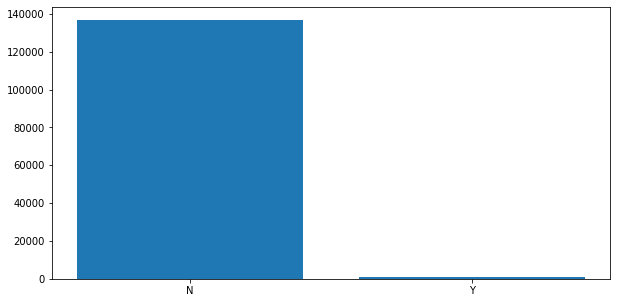

In [70]:
plt.figure(figsize=(10,5))
plt.bar(df['neo'].value_counts().index , df['neo'].value_counts().values);
plt.show()

<a id="t3.16."></a>
## 3.16. Exploration of pha (Pha -> Physically Hazardous Asteroid )

In [71]:
df['pha'].describe()

count     137680
unique         2
top            N
freq      137459
Name: pha, dtype: object

In [72]:
df['pha'].value_counts()

N    137459
Y       221
Name: pha, dtype: int64

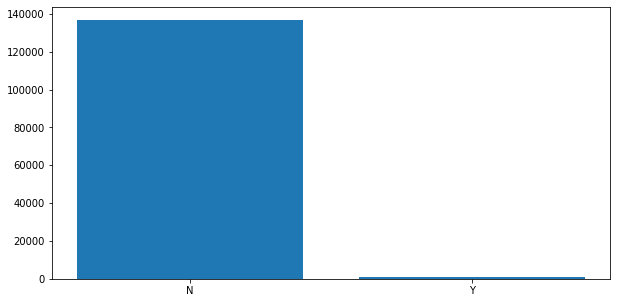

In [73]:
plt.figure(figsize=(10,5))
plt.bar(df['neo'].value_counts().index , df['neo'].value_counts().values);
plt.show()

# <a id="t3.17."></a>
## 3.17. Exploration of albedo (Albedo -> geometric albedo)

In [74]:
df['albedo'].describe()

count    137680.000000
mean         -2.345567
std           0.761354
min          -6.907755
25%          -2.937463
50%          -2.551046
75%          -1.676647
max           0.000000
Name: albedo, dtype: float64

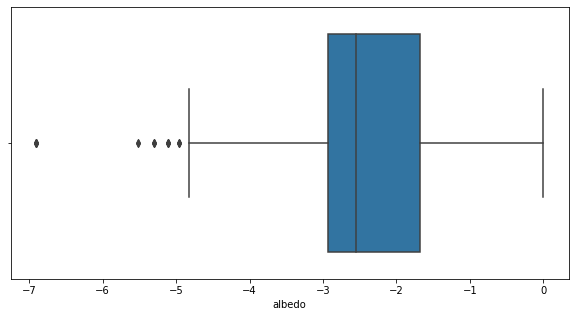

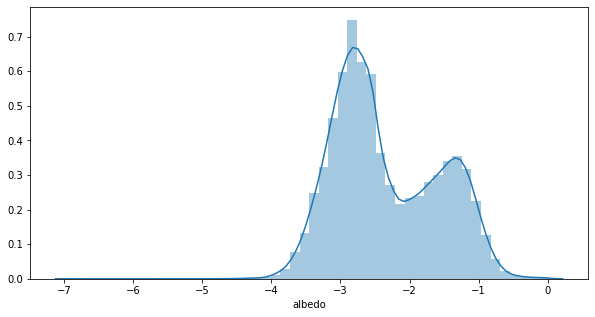

In [75]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['albedo'])
plt.show()


plt.figure(figsize=(10,5))
sns.distplot(df['albedo']);
plt.show()

<a id="t3.18."></a>
## 3.18. Exploration of moid (Moid -> Earth Minimum orbit Intersection Distance)

In [76]:
df['moid'].describe()

count    137680.000000
mean          0.290510
std           0.395031
min          -8.701164
25%           0.079245
50%           0.325621
75%           0.530238
max           3.676478
Name: moid, dtype: float64

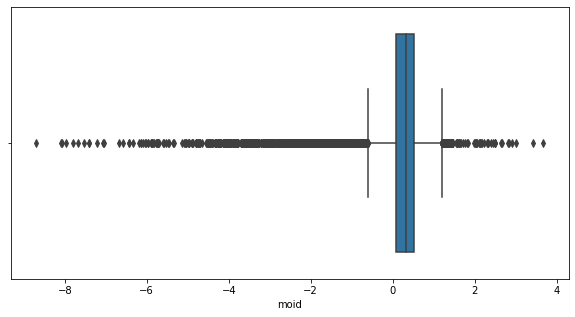

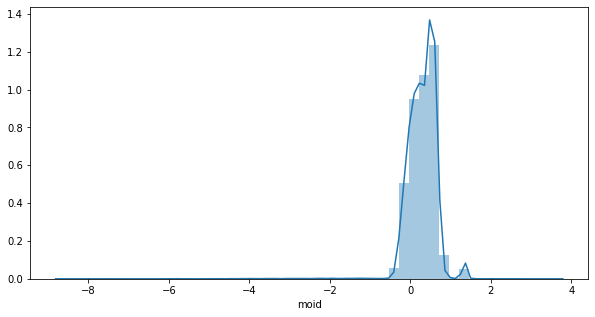

In [77]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
sns.boxplot(x=df['moid'])
plt.show()


plt.figure(figsize=(10,5))
sns.distplot(df['moid']);
plt.show()

<a id="t3.19."></a>
## 3.19. Heatmap

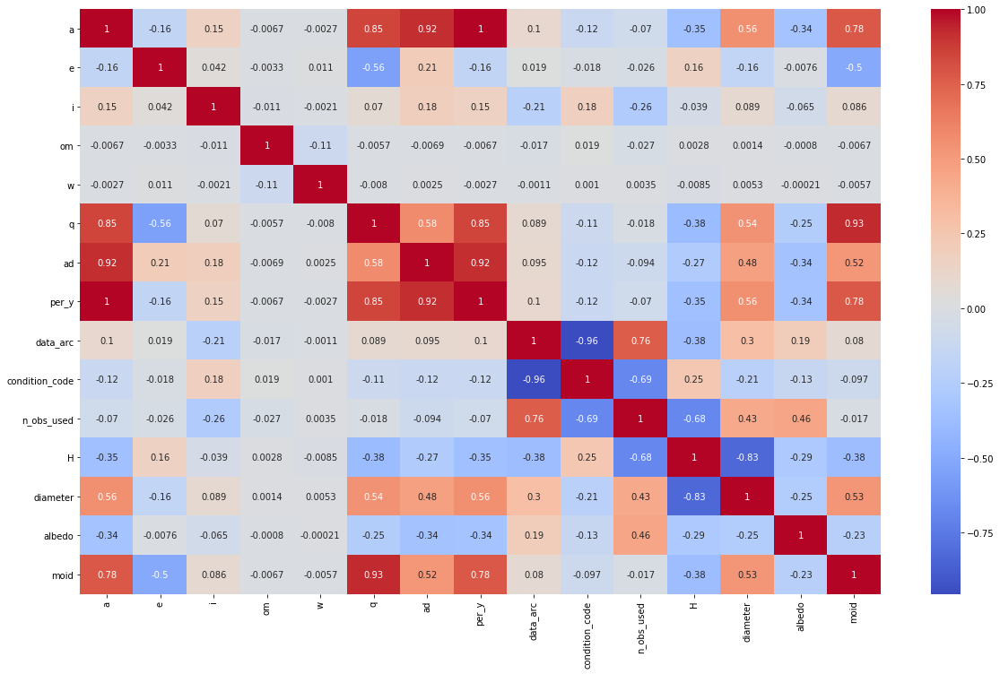

In [78]:
# Figure size
cor=df.corr()
plt.figure(figsize=(20,12))

# Heatmap
sns.heatmap(cor, cmap="coolwarm", annot=True)
plt.show()

<a id="t2.6."></a>
##  Get dummies

In [79]:
new_condition_code = pd.get_dummies(df.condition_code, drop_first = True,prefix='condition_code')
new_neo = pd.get_dummies(df.neo, drop_first = True,prefix='neo')
new_pha = pd.get_dummies(df.pha, drop_first = True,prefix='pha')
df1= pd.concat([df,new_condition_code,new_neo,new_pha], axis=1)
df1.head()

,a,e,i,om,w,q,ad,per_y,data_arc,condition_code,...,condition_code_2,condition_code_3,condition_code_4,condition_code_5,condition_code_6,condition_code_7,condition_code_8,condition_code_9,neo_Y,pha_Y
0,1.018546,-2.576903,2.360294,80.305532,73.597694,0.939493,1.091805,1.527838,9.085004,0,...,0,0,0,0,0,0,0,0,0,0
1,1.019737,-1.468213,3.550658,173.080063,310.048857,0.757935,1.227025,1.529625,11.188828,0,...,0,0,0,0,0,0,0,0,0,0
2,0.981760,-1.358904,2.564097,169.852760,248.138626,0.684778,1.210442,1.472659,11.193877,0,...,0,0,0,0,0,0,0,0,0,0
3,0.859262,-2.422253,1.965961,103.810804,150.728541,0.766356,0.944266,1.288912,10.097738,0,...,0,0,0,0,0,0,0,0,0,0
4,0.945558,-1.654987,1.680267,141.576604,358.687608,0.733485,1.120430,1.418356,11.057708,0,...,0,0,0,0,0,0,0,0,0,0


In [80]:
df1.drop(['condition_code','neo','pha',],axis=1,inplace=True)
df1.head(2)

,a,e,i,om,w,q,ad,per_y,data_arc,n_obs_used,...,condition_code_2,condition_code_3,condition_code_4,condition_code_5,condition_code_6,condition_code_7,condition_code_8,condition_code_9,neo_Y,pha_Y
0,1.018546,-2.576903,2.360294,80.305532,73.597694,0.939493,1.091805,1.527838,9.085004,6.909753,...,0,0,0,0,0,0,0,0,0,0
1,1.019737,-1.468213,3.550658,173.080063,310.048857,0.757935,1.227025,1.529625,11.188828,9.046644,...,0,0,0,0,0,0,0,0,0,0


In [81]:
df1.to_csv('asteroid_cohe.csv') 

In [82]:
df2=pd.read_csv('asteroid_cohe.csv', )
df2.drop(['Unnamed: 0'], axis=1,inplace=True)
df2.head()

,a,e,i,om,w,q,ad,per_y,data_arc,n_obs_used,...,condition_code_2,condition_code_3,condition_code_4,condition_code_5,condition_code_6,condition_code_7,condition_code_8,condition_code_9,neo_Y,pha_Y
0,1.018546,-2.576903,2.360294,80.305532,73.597694,0.939493,1.091805,1.527838,9.085004,6.909753,...,0,0,0,0,0,0,0,0,0,0
1,1.019737,-1.468213,3.550658,173.080063,310.048857,0.757935,1.227025,1.529625,11.188828,9.046644,...,0,0,0,0,0,0,0,0,0,0
2,0.981760,-1.358904,2.564097,169.852760,248.138626,0.684778,1.210442,1.472659,11.193877,8.868413,...,0,0,0,0,0,0,0,0,0,0
3,0.859262,-2.422253,1.965961,103.810804,150.728541,0.766356,0.944266,1.288912,10.097738,9.140454,...,0,0,0,0,0,0,0,0,0,0
4,0.945558,-1.654987,1.680267,141.576604,358.687608,0.733485,1.120430,1.418356,11.057708,7.958926,...,0,0,0,0,0,0,0,0,0,0


In [83]:
X=df2.drop(['diameter'],axis=1)
y=df2['diameter']

import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
plt.title('With Outlier')
sns.boxplot(x=df2['diameter'])
plt.show()

# identifying the quantile range 
Q1 = df2['diameter'].quantile(0.25)
Q3 = df2['diameter'].quantile(0.75)
IQR = Q3 - Q1

# removing the outlier range 
df2 = df2[~((df2['diameter'] < (Q1 - 1.5 * IQR)) |(df2['diameter'] > (Q3 + 1.5 * IQR)))]

# after removing the outlier
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
plt.title('Without Outlier')
sns.boxplot(x=df2['diameter'])
plt.show()

# Distribution on rent 
plt.figure(figsize=(10,5))
sns.distplot(df2['diameter']);
plt.show()

X=df2.drop(['diameter'],axis=1)
y=df2['diameter']

<a id="t4."></a>
# 4. Modelling

In [84]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 10)

# Feature Scaling
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

<a id="t4.1."></a>
# 4.1. Linear Regression

In [86]:
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error
from sklearn.linear_model import LinearRegression

# Fitting Multiple Linear Regression to the Training set
Multiple_regressor = LinearRegression()
Multiple_regressor.fit(X_train, y_train)

#prediciting the values of both train and test using the model 
y_train_pred = Multiple_regressor.predict(X_train)
y_test_pred = Multiple_regressor.predict(X_test)


# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

R_SQAURE_score is 0.9600280257554226

Training RMSE is 0.1261702193619881
Testing RMSE is 0.12828407936203684


<a id="t4.2."></a>
# 4.2. Ridge Regression

R_SQAURE_score is 0.9600288562223486

Training RMSE is 0.1261710045368045
Testing RMSE is 0.12828274672535314


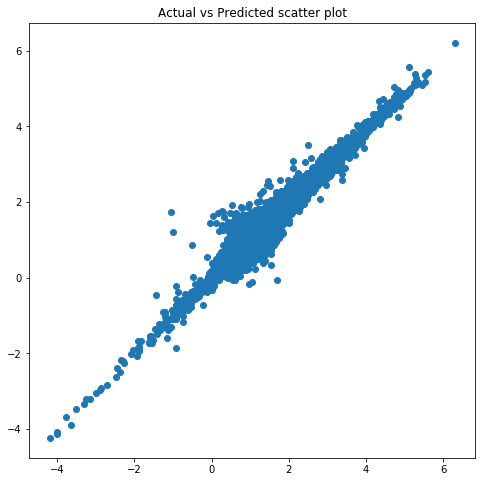

In [87]:

from sklearn.linear_model import Ridge
Ridge_regressor = Ridge(alpha=0.05)
Ridge_regressor.fit(X_train , y_train)

#prediciting the values of both train and test using the model 
y_train_pred = Ridge_regressor.predict(X_train)
y_test_pred = Ridge_regressor.predict(X_test)

# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

<a id="t4.2.1."></a>
# 4.2.1. Ridge Regression using Cross Validation

R_SQAURE_score is 0.9600289341894784

Training RMSE is 0.12617100683172852
Testing RMSE is 0.12828262161206502


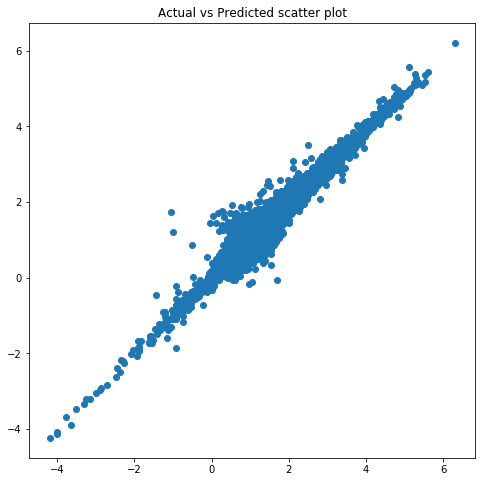

In [88]:
from sklearn.linear_model import RidgeCV
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error

Ridge_regressor_cv = RidgeCV()
Ridge_regressor_cv.fit(X_train , y_train)

#prediciting the values of both train and test using the model 
y_train_pred = Ridge_regressor_cv.predict(X_train)
y_test_pred = Ridge_regressor_cv.predict(X_test)

# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

<a id="t4.3."></a>
# 4.3. Lasso Regression 

In [89]:
from sklearn.linear_model import Lasso
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error

# training the model
Lasso_regressor = Lasso(alpha=0.05)
Lasso_regressor.fit(X_train , y_train)

#prediciting the values of both train and test using the model 
y_train_pred = Lasso_regressor.predict(X_train)
y_test_pred = Lasso_regressor.predict(X_test)


# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

R_SQAURE_score is 0.941258340047614

Training RMSE is 0.1538206321450973
Testing RMSE is 0.1555134907024988


<a id="t4.3.1."></a>
# 4.3.1. Lasso Regression using Cross validation 

In [90]:
from sklearn.linear_model import LassoCV
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error

# training the model
Lasso_regressor_cv = LassoCV()
Lasso_regressor_cv.fit(X_train , y_train)

#prediciting the values of both train and test using the model 
y_train_pred = Lasso_regressor_cv.predict(X_train)
y_test_pred = Lasso_regressor_cv.predict(X_test)


# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

R_SQAURE_score is 0.9599383475686635

Training RMSE is 0.12624126825158108
Testing RMSE is 0.1284279031101892


<a id="t4.4."></a>
# 4.4. ElasticNet Regression

In [91]:
from sklearn.linear_model import ElasticNet
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error

# training the model
ElasticNet_regressor = ElasticNet(alpha=0.05)
ElasticNet_regressor.fit(X_train , y_train)

#prediciting the values of both train and test using the model 
y_train_pred = ElasticNet_regressor.predict(X_train)
y_test_pred = ElasticNet_regressor.predict(X_test)


# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

R_SQAURE_score is 0.9500274668693459

Training RMSE is 0.14167209820522664
Testing RMSE is 0.14343681877900594


<a id="t4.4.1."></a>
# 4.4.1. ElasticNet Regression CV

R_SQAURE_score is 0.9599431538843158

Training RMSE is 0.12624445055616756
Testing RMSE is 0.12842019894026185


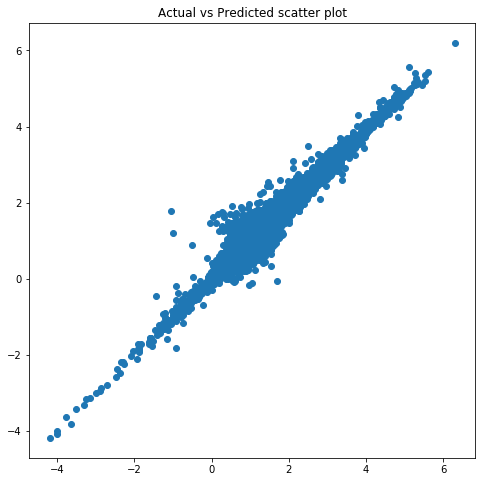

In [92]:
# elastic net cv
from sklearn.linear_model import ElasticNetCV
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error

# training the model
ElasticNet_regressor_cv = ElasticNetCV()
ElasticNet_regressor_cv.fit(X_train , y_train)

#prediciting the values of both train and test using the model 
y_train_pred = ElasticNet_regressor_cv.predict(X_train)
y_test_pred = ElasticNet_regressor_cv.predict(X_test)


# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

<a id="t4.5."></a>
# 4.5. Support vector Regression RBF kernel

R_SQAURE_score is 0.9584224514099124

Training RMSE is 0.11790132416772026
Testing RMSE is 0.1308351396305785


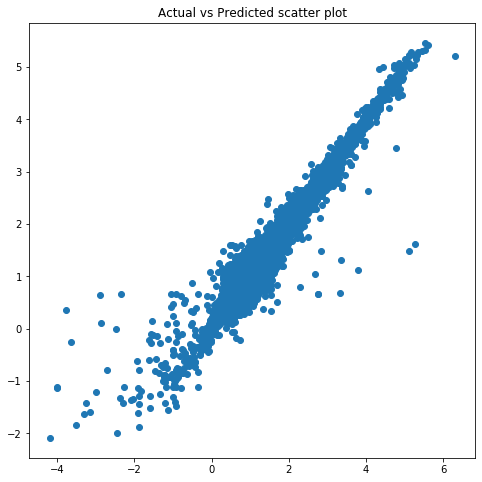

In [93]:
from sklearn.svm import SVR
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error

# training the model 
SupportVector_regressor =SVR()  
SupportVector_regressor.fit(X_train, y_train) 

#prediciting the values of both train and test using the model 
y_train_pred = SupportVector_regressor.predict(X_train)
y_test_pred = SupportVector_regressor.predict(X_test)

# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

<a id="t4.6."></a>
# 4.6. Support Vector Regressor Linear Kernel 

In [ ]:
from sklearn.svm import SVR
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error

# training the model 
SupportVector_regressor =SVR(kernel='linear')  
SupportVector_regressor.fit(X_train, y_train) 

#prediciting the values of both train and test using the model 
y_train_pred = SupportVector_regressor.predict(X_train)
y_test_pred = SupportVector_regressor.predict(X_test)

# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

<a id="t4.7."></a>
# 4.7. DecisionTree Regression 

R_SQAURE_score is 0.9458280035661971

Training RMSE is 4.501299869522622e-05
Testing RMSE is 0.14934214436066165


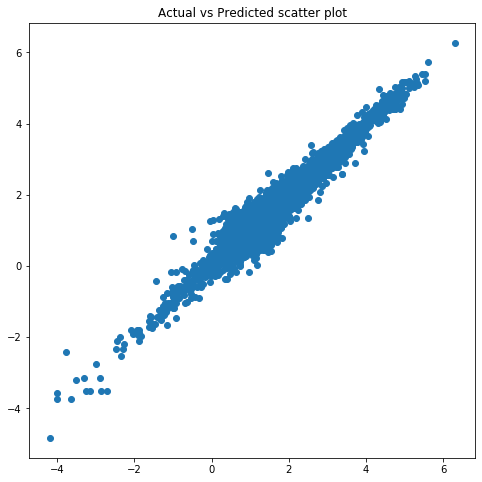

In [85]:
from sklearn.tree import DecisionTreeRegressor
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error

# Training the model
DecisionTree_regressor = DecisionTreeRegressor(random_state = 0)  
DecisionTree_regressor.fit(X_train, y_train) 

#prediciting the values of both train and test using the model 
y_train_pred = DecisionTree_regressor.predict(X_train)
y_test_pred = DecisionTree_regressor.predict(X_test)


# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

### CONCLUSION:-

##### -->The above code produces a R2 score value of 94.58%.

##### -->	As the difference between training and testing MSE and RMSE is more the model may have some overfitting .

##### -->The above graph show the relation between actual vs predicted diameter.

<a id="t4.7.1"></a>
# 4.7.1. DecisionTree Regression  with GridSearchCV

R_SQAURE_score is 0.9666507038348828

Training RMSE is 0.10732186801370307
Testing RMSE is 0.11717590019500093

The best parameters for the tree where : {'max_depth': 10, 'max_features': None, 'max_leaf_nodes': None} 


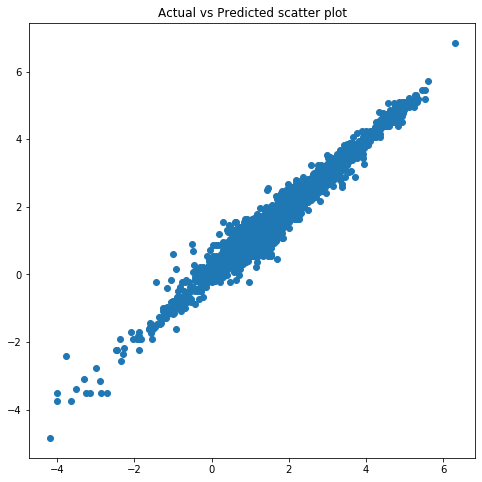

In [86]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error


param_grid = {'max_depth': [2, 3, 5, 6, 8, 10, 15, 20, 30, 50,None],
              'max_leaf_nodes': [2, 3, 4, 5, 10, 15, 20,None],
              'max_features': [4, 8, 20, 25,None]}

DecisionTree_regressor = DecisionTreeRegressor(random_state=9)
grid_DecisionTree_regressor = GridSearchCV(estimator=DecisionTree_regressor,param_grid=param_grid,cv = 5,n_jobs=-1,scoring='r2')
grid_DecisionTree_regressor.fit(X_train,y_train)

y_train_pred = grid_DecisionTree_regressor.predict(X_train)
y_test_pred = grid_DecisionTree_regressor.predict(X_test)
score = r2_score(y_test,y_test_pred)

Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
RMSE = np.sqrt(mean_squared_error(y_test,y_test_pred))
parameter = grid_DecisionTree_regressor.best_params_

print('R_SQAURE_score is {}'.format(score))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(RMSE))
print()
print('The best parameters for the tree where : {} '.format(parameter))

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

### CONCLUSION:-

##### -->The above code produces a R2 score value of 96.66%.

##### -->	As the difference between training and testing MSE and RMSE is less the model  is not having overfitting .

##### -->The above graph show the relation between actual vs predicted diameter.

<a id="t4.8."></a>
# 4.8. RandomForest Regression

R_SQAURE_score is 0.9683462915117105

Training RMSE is 0.053432486586737465
Testing RMSE is 0.1141582392151965


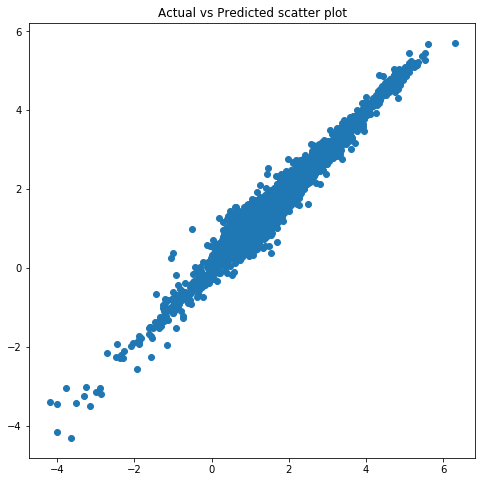

In [87]:
from sklearn.ensemble import RandomForestRegressor
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error 

# Training the model
RandomForest_regressor = RandomForestRegressor(n_estimators=5)  
RandomForest_regressor.fit(X_train, y_train) 

#prediciting the values of both train and test using the model 
y_train_pred = RandomForest_regressor.predict(X_train)
y_test_pred = RandomForest_regressor.predict(X_test)

# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
r2 = r2_score(y_test , y_test_pred)

# Displaying the value 
print('R_SQAURE_score is {}'.format(r2))
print()
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

### CONCLUSION:-

##### -->The above code produces a R2 score value of 96.83%.

##### -->	As the difference between training and testing MSE and RMSE is more the model may have some overfitting .

##### -->The above graph show the relation between actual vs predicted diameter.

<a id="t4.8.1"></a>
# 4.8.1. RandomForest Regression Gridsearch CV

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
import numpy as np
from sklearn.metrics import r2_score , mean_squared_error


param_grid = {'max_depth': [2, 3, 5, 6, 8, 10, 15, 20, 30, 50,None],
              'max_leaf_nodes': [2, 3, 4, 5, 10, 15, 20,None],
              'max_features': [4,6, 8,10,12,14,16,18, 20, 25,None]}

RandomForest_regressor = RandomForestRegressor(random_state=42)
grid_RandomForest_regressor = GridSearchCV(estimator=RandomForest_regressor,param_grid=param_grid,n_iter = 100, cv = 3, verbose=2,n_jobs=-1,scoring='r2')
grid_RandomForest_regressor.fit(X_train,y_train)

y_pred = grid_RandomForest_regressor.predict(X_test)
score = r2_score(y_test,y_pred)
RMSE = np.sqrt(mean_squared_error(y_test,y_pred))
parameter = grid_DecisionTree_regressor.best_params_

print('R_SQAURE_score is {}'.format(score))
print('Testing RMSE is {}'.format(RMSE))
print()
print('The best parameters for the tree where : {} '.format(parameter))

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_pred)
plt.show()

<a id="t4.9."></a>
# 4.9. BAGGING META-ESTIMATOR

R_SQAURE_score is 0.9707644787569447
Training RMSE is 0.04687943212357874
Testing RMSE is 0.10971105289792082



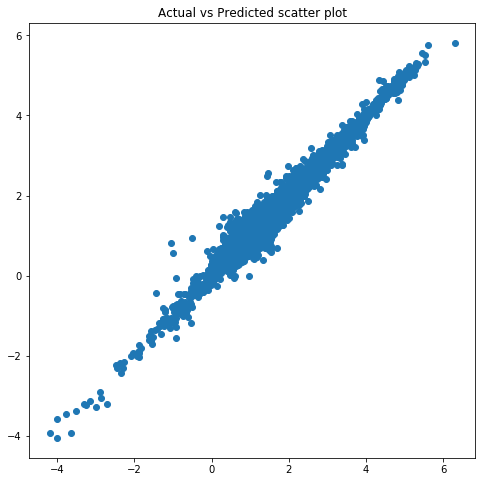

In [88]:
from sklearn import tree
from sklearn.ensemble import BaggingRegressor
from sklearn.metrics import r2_score , mean_squared_error

model = BaggingRegressor(tree.DecisionTreeRegressor(random_state=1))
model.fit(X_train, y_train)
model.score(X_test,y_test)

#prediciting the values of both train and test using the model 
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
score = r2_score(y_test,y_test_pred)
RMSE = np.sqrt(mean_squared_error(y_test,y_test_pred))


print('R_SQAURE_score is {}'.format(score))
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))
print()

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

### CONCLUSION:-

##### -->The above code produces a R2 score value of 97.07%.

##### -->	As the difference between training and testing MSE and RMSE is more the model may have some overfitting .

##### -->The above graph show the relation between actual vs predicted diameter.

<a id="t4.10."></a>
# 4.10. ADABOOST

R_SQAURE_score is 0.749888461491286
Training RMSE is 0.32010628696196586
Testing RMSE is 0.3208941694683027



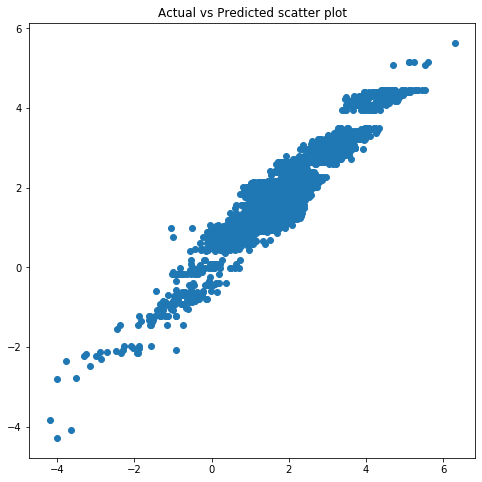

In [89]:
from sklearn.ensemble import AdaBoostRegressor
model = AdaBoostRegressor()
model.fit(X_train, y_train)
model.score(X_test,y_test)

#prediciting the values of both train and test using the model 
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
score = r2_score(y_test,y_test_pred)
RMSE = np.sqrt(mean_squared_error(y_test,y_test_pred))


print('R_SQAURE_score is {}'.format(score))
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))
print()

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

### CONCLUSION:-

##### -->The above code produces a R2 score value of 74.98%.

##### -->	As the difference between training and testing MSE and RMSE is less the model is not having overfitting .

##### -->The above graph show the relation between actual vs predicted diameter.

<a id="t4.11."></a>
# 4.11. GRADIENT BOOSTING(GBM)

R_SQAURE_score is 0.9658635791522068
Training RMSE is 0.11547878630875896
Testing RMSE is 0.11855065405576787



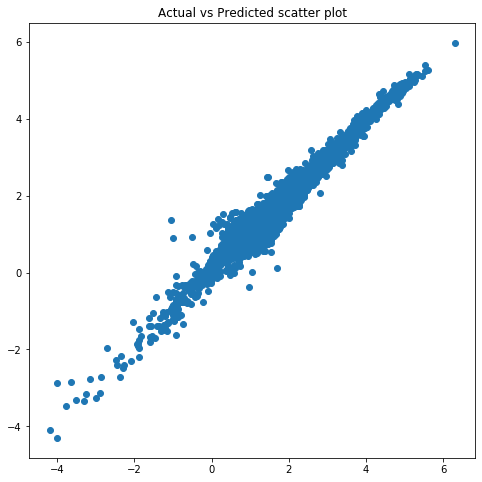

In [90]:
from sklearn.ensemble import GradientBoostingRegressor
model= GradientBoostingRegressor()
model.fit(X_train, y_train)
model.score(X_test,y_test)


#prediciting the values of both train and test using the model 
y_train_pred = model.predict(X_train)
y_test_pred =model.predict(X_test)

# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
score = r2_score(y_test,y_test_pred)
RMSE = np.sqrt(mean_squared_error(y_test,y_test_pred))


print('R_SQAURE_score is {}'.format(score))
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))
print()


# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

### CONCLUSION:-

##### -->The above code produces a R2 score value of 96.58%.

##### -->	As the difference between training and testing MSE and RMSE is less the model is not having overfitting .

##### -->The above graph show the relation between actual vs predicted diameter.

<a id="t4.12."></a>
# 4.12. XGBOOST

R_SQAURE_score is 0.9727367914633204
Training RMSE is 0.09290451809691336
Testing RMSE is 0.105945726914293



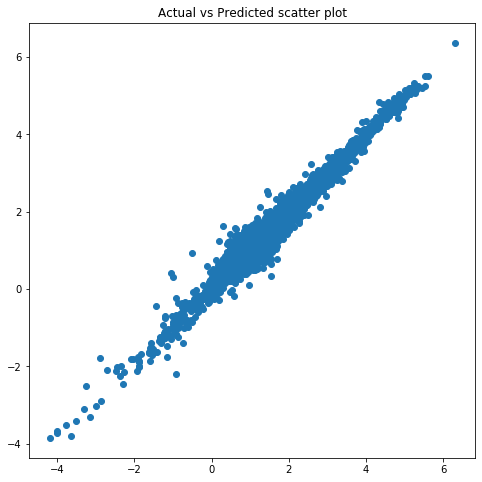

In [91]:
import xgboost as xgb
model=xgb.XGBRegressor()
model.fit(X_train, y_train)
model.score(X_test,y_test)

#prediciting the values of both train and test using the model 
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# training and testing RMSE
Train_RMSE = np.sqrt(mean_squared_error(y_train , y_train_pred))
Test_RMSE = np.sqrt(mean_squared_error(y_test , y_test_pred))

# R-square score
score = r2_score(y_test,y_test_pred)
RMSE = np.sqrt(mean_squared_error(y_test,y_test_pred))


print('R_SQAURE_score is {}'.format(score))
print('Training RMSE is {}'.format(Train_RMSE))
print('Testing RMSE is {}'.format(Test_RMSE))
print()

# visualing the actual against predicted values
plt.figure(figsize=(8,8))
plt.title('Actual vs Predicted scatter plot')
plt.scatter(y_test, y_test_pred)
plt.show()

### CONCLUSION:-

##### -->The above code produces a R2 score value of 97.27%.

##### -->	As the difference between training and testing MSE and RMSE is less the model is not having overfitting .

##### -->The above graph show the relation between actual vs predicted diameter.